In [1]:
import torch
import torchvision.models as models
from torchvision import transforms, datasets
from torch.utils.data import DataLoader
import torch.nn as nn
import torch.optim as optim
from PIL import Image
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt


In [2]:
data_dir = 'datasets_Cats_vs_Dogs'

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# 加載數據集
train_dataset = datasets.ImageFolder(root=os.path.join(data_dir, 'train'), transform=transform)
test_dataset = datasets.ImageFolder(root=os.path.join(data_dir, 'test'), transform=transform)

train_loader = DataLoader(dataset=train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=32, shuffle=False)

val_dataset = datasets.ImageFolder(root=os.path.join(data_dir, 'val'), transform=transform)
val_loader = DataLoader(dataset=val_dataset, batch_size=32, shuffle=False)



In [3]:
model = models.resnet101(pretrained=True)
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs,2)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = 0.0001)

d:\Anaconda\envs\cvgogo\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\Anaconda\envs\cvgogo\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [4]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
model = model.to(device)

cuda:0


In [5]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)

num_epochs = 5
best_accuracy = 0
best_model_path = ''

train_losses = []
test_accuracies = []
val_accuracies = []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    
    # 訓練損失
    epoch_loss = running_loss / len(train_loader)
    train_losses.append(epoch_loss)
    
    # 測試準確率
    model.eval()
    with torch.no_grad():
        correct = 0
        total = 0
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
        test_accuracy = 100 * correct / total
        test_accuracies.append(test_accuracy)
    
    # 驗證準確率
    with torch.no_grad():
        correct = 0
        total = 0
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
        val_accuracy = 100 * correct / total
        val_accuracies.append(val_accuracy)

    if test_accuracy > best_accuracy:
        best_accuracy = test_accuracy
        best_model_path = f'2_model_epoch_{epoch}.pth'
        torch.save(model.state_dict(), best_model_path)
        
    print(f'Epoch {epoch+1}, Loss: {epoch_loss:.4f}, Test Acc: {test_accuracy:.2f}, Val Acc: {val_accuracy:.2f}')

if best_model_path:
    model.load_state_dict(torch.load(best_model_path))
    model.eval()
    print(f'Loaded best model from: {best_model_path}')
else:
    print('No best model found.')


KeyboardInterrupt: 

In [ ]:
model.load_state_dict(torch.load('model_epoch_2.pth'))
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# 加載驗證集
val_dataset = datasets.ImageFolder('datasets_Cats_vs_Dogs/val', transform=transform)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# 評估模型
model.eval()
corrects = 0
total = 0

with torch.no_grad():
    for inputs, labels in val_loader:
        inputs, labels = inputs.to('cuda'), labels.to('cuda')
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        corrects += torch.sum(preds == labels.data)
        total += labels.size(0)

accuracy = corrects.double() / total
print(f'Validation Accuracy: {accuracy:.4f}')

Validation Accuracy: 0.9825


Dog


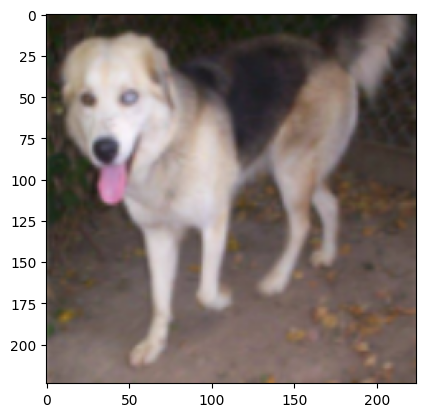

d:\Anaconda\envs\cvgogo\lib\site-packages\torch\nn\modules\module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


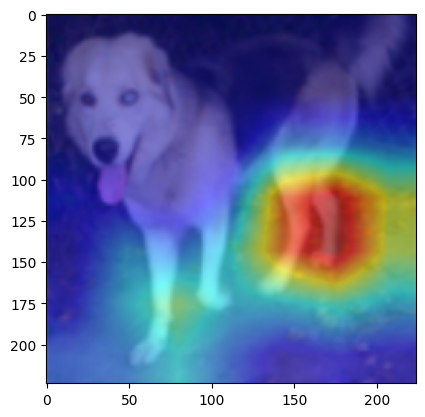

In [ ]:
def predict(image_path, model, transform):
    image = Image.open(image_path)
    image = transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        output = model(image)
        _, predicted = torch.max(output.data, 1)
    return 'Cat' if predicted.item() == 0 else 'Dog'



def preprocess_image(img_path):
    transform = transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    img = Image.open(img_path).convert('RGB')
    img = transform(img).unsqueeze(0)
    return img

def generate_cam(model, target_layer, img_tensor, class_idx=None):
    model.eval()
    feature_maps = []
    gradients = []

    def forward_hook(module, input, output):
        feature_maps.append(output)

    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])

    handle_forward = target_layer.register_forward_hook(forward_hook)
    handle_backward = target_layer.register_backward_hook(backward_hook)

    output = model(img_tensor)
    if class_idx is None:
        class_idx = torch.argmax(output).item()

    model.zero_grad()
    class_loss = output[0, class_idx]
    class_loss.backward()

    handle_forward.remove()
    handle_backward.remove()

    feature_map = feature_maps[0].detach().cpu().numpy()[0]
    gradient = gradients[0].detach().cpu().numpy()[0]

    weights = np.mean(gradient, axis=(1, 2))
    cam = np.sum(weights[:, np.newaxis, np.newaxis] * feature_map, axis=0)
    cam = np.maximum(cam, 0)
    cam = cam / cam.max()
    cam = cv2.resize(cam, (img_tensor.size(2), img_tensor.size(3)))

    return cam

def show_cam_on_image(img_path, cam):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    cam = 1 - cam
    
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255

    heatmap = cv2.resize(heatmap, (img.shape[1],img.shape[0]))

    superimposed_img = heatmap + np.float32(img) / 255
    superimposed_img = superimposed_img / np.max(superimposed_img)
    plt.imshow(np.uint8(255 * superimposed_img))
    plt.show()

def resize_image(image_path, output_path, size=(224, 224)):
    # 读取图像
    img = cv2.imread(image_path)
    
    # 调整图像尺寸
    resized_img = cv2.resize(img, size)
    
    # 保存调整后的图像
    cv2.imwrite(output_path, resized_img)

# 调整 temp.png 的尺寸
resize_image('temp.png', 'resized_temp.png')


image_path = 'resized_temp.png'
print(predict(image_path, model, transform))
plt.imshow(plt.imread(image_path))
plt.show()

# 選擇目標層，這裡使用 ResNet101 的 layer4
target_layer = model.layer4[-1]

img_tensor = preprocess_image(image_path).to(device)

cam = generate_cam(model, target_layer, img_tensor)

show_cam_on_image(image_path, cam)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# 加载预训练的 ResNet101 模型
model_fc = model.load_state_dict(torch.load('model_epoch_2.pth'))
# 去除全连接层
model_fc = nn.Sequential(*list(model.children())[:-1])

# 设置为评估模式
model_fc.eval()

# 图像预处理
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


# 获取特征
def extract_features(loader):
    features = []
    labels = []
    with torch.no_grad():
        for inputs, targets in loader:
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)
            outputs = outputs.view(outputs.size(0), -1)  # 展平成一维
            features.append(outputs.cpu().numpy())
            labels.append(targets.cpu().numpy())
    return np.concatenate(features), np.concatenate(labels)

train_features, train_labels = extract_features(train_loader)
test_features, test_labels = extract_features(test_loader)

# 训练随机森林分类器
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(train_features, train_labels)

# 进行分类预测
train_predictions = rf_classifier.predict(train_features)
test_predictions = rf_classifier.predict(test_features)

# 打印准确率
train_accuracy = accuracy_score(train_labels, train_predictions)
test_accuracy = accuracy_score(test_labels, test_predictions)

print(f'Train Accuracy: {train_accuracy * 100:.2f}%')
print(f'Test Accuracy: {test_accuracy * 100:.2f}%')

Train Accuracy: 100.00%
Test Accuracy: 98.60%


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import torch
import torch.nn as nn
from torchvision import transforms
import numpy as np

# 加载预训练的 ResNet101 模型
model_fc = model.load_state_dict(torch.load('model_epoch_2.pth'))
# 去除全连接层
model_fc = nn.Sequential(*list(model.children())[:-1])

# 设置为评估模式
model_fc.eval()

# 图像预处理
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# 获取特征
def extract_features(loader):
    features = []
    labels = []
    with torch.no_grad():
        for inputs, targets in loader:
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)
            outputs = outputs.view(outputs.size(0), -1)  # 展平成一维
            features.append(outputs.cpu().numpy())
            labels.append(targets.cpu().numpy())
    return np.concatenate(features), np.concatenate(labels)

# 提取特征
train_features, train_labels = extract_features(train_loader)
test_features, test_labels = extract_features(test_loader)
val_features, val_labels = extract_features(val_loader)

# 训练随机森林分类器
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(train_features, train_labels)

# 进行分类预测
train_predictions = rf_classifier.predict(train_features)
test_predictions = rf_classifier.predict(test_features)
val_predictions = rf_classifier.predict(val_features)

# 打印准确率
train_accuracy = accuracy_score(train_labels, train_predictions)
test_accuracy = accuracy_score(test_labels, test_predictions)
val_accuracy = accuracy_score(val_labels, val_predictions)

print(f'Train Accuracy: {train_accuracy * 100:.2f}%')
print(f'Test Accuracy: {test_accuracy * 100:.2f}%')
print(f'Validation Accuracy: {val_accuracy * 100:.2f}%')


Train Accuracy: 100.00%
Test Accuracy: 98.56%
Validation Accuracy: 98.50%


In [ ]:
from torchsummary import summary

summary(model_fc, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          16,384
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
print(model_fc)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


Feature count: 10, RF Accuracy: 0.9808, LR Accuracy: 0.9794
Feature count: 100, RF Accuracy: 0.9864, LR Accuracy: 0.9874
Feature count: 500, RF Accuracy: 0.9860, LR Accuracy: 0.9868
Feature count: 1000, RF Accuracy: 0.9862, LR Accuracy: 0.9864
Feature count: 2048, RF Accuracy: 0.9854, LR Accuracy: 0.9872


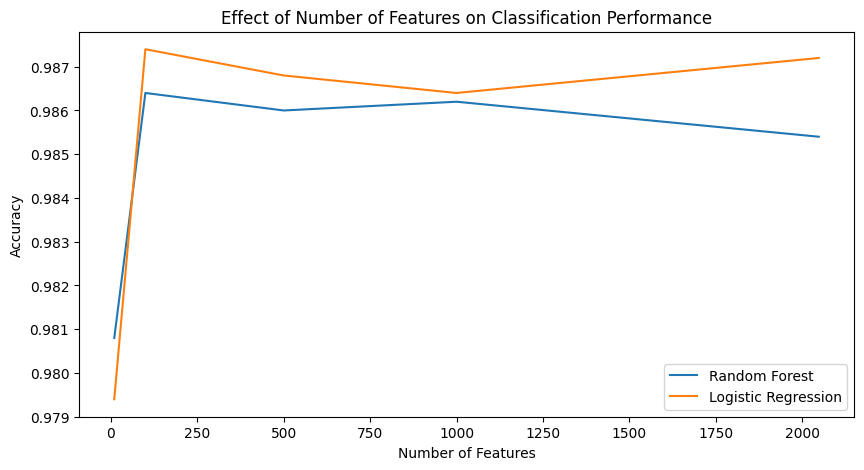

In [ ]:
from sklearn.linear_model import LogisticRegression

importances = rf_classifier.feature_importances_
indices = np.argsort(importances)[::-1]

# 函数：训练和评估分类器
def train_and_evaluate_classifier(features, labels, test_features, test_labels, n_features, classifier_type='rf'):
    selected_indices = indices[:n_features]
    selected_train_features = features[:, selected_indices]
    selected_test_features = test_features[:, selected_indices]
    
    if classifier_type == 'rf':
        classifier = RandomForestClassifier(n_estimators=100, random_state=42)
    elif classifier_type == 'lr':
        classifier = LogisticRegression(max_iter=1000)
    
    classifier.fit(selected_train_features, labels)
    predictions = classifier.predict(selected_test_features)
    accuracy = accuracy_score(test_labels, predictions)
    return accuracy

# 不同特征数量对分类性能的影响
feature_counts = [10, 100, 500, 1000, train_features.shape[1]]
results_rf = []
results_lr = []

for count in feature_counts:
    accuracy_rf = train_and_evaluate_classifier(train_features, train_labels, test_features, test_labels, count, 'rf')
    accuracy_lr = train_and_evaluate_classifier(train_features, train_labels, test_features, test_labels, count, 'lr')
    results_rf.append(accuracy_rf)
    results_lr.append(accuracy_lr)
    print(f'Feature count: {count}, RF Accuracy: {accuracy_rf:.4f}, LR Accuracy: {accuracy_lr:.4f}')

# 可视化结果
plt.figure(figsize=(10, 5))
plt.plot(feature_counts, results_rf, label='Random Forest')
plt.plot(feature_counts, results_lr, label='Logistic Regression')
plt.xlabel('Number of Features')
plt.ylabel('Accuracy')
plt.title('Effect of Number of Features on Classification Performance')
plt.legend()
plt.show()

In [ ]:
def extract_feature_maps(loader):
    feature_maps = []
    labels = []
    with torch.no_grad():
        for inputs, targets in loader:
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)
            feature_maps.append(outputs.squeeze().cpu().numpy())
            labels.append(targets.numpy())  # 只取单个标签
    return np.array(feature_maps), np.array(labels)

# 提取特征映射（这里选择第一个卷积层）
feature_maps, labels = extract_feature_maps(train_loader)
importances = rf_classifier.feature_importances_


feature_maps, labels = extract_feature_maps(train_loader)

n_top_features = 5
top5_feature_indices = np.argsort(importances)[::-1][:n_top_features]
print("Top 5 important feature indices for cat class:", top5_feature_indices)


Top 5 important feature indices for cat class: [1031  236 1377  127  723]


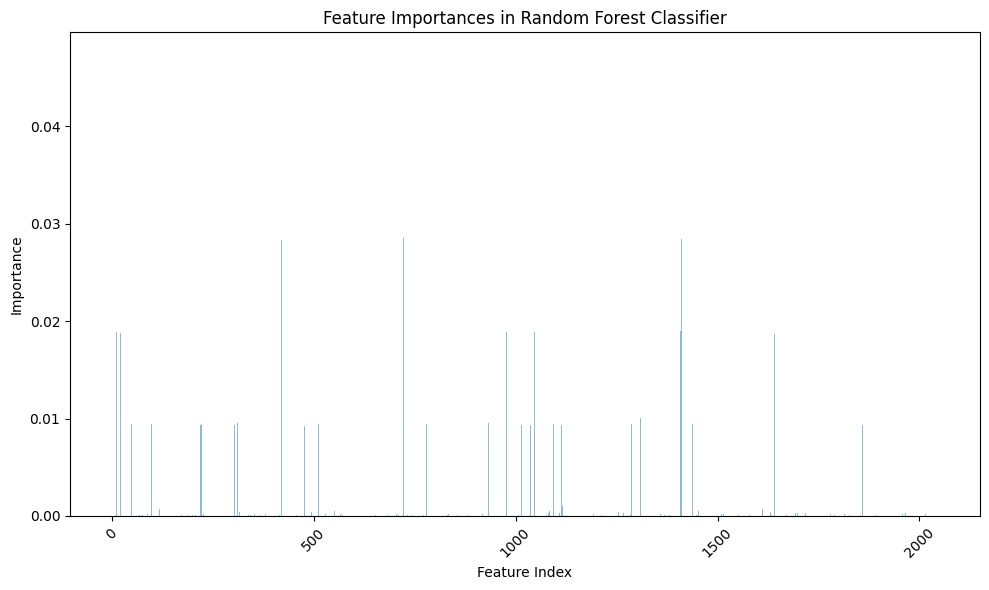

In [ ]:
# 获取特征重要度
importances = rf_classifier.feature_importances_

# 特征数目
n_features = len(importances)

feature_indices = range(n_features)

plt.figure(figsize=(10, 6))
plt.bar(feature_indices, importances, align='center', alpha=0.5)
plt.xlabel('Feature Index')
plt.ylabel('Importance')
plt.title('Feature Importances in Random Forest Classifier')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
from torchvision.datasets import ImageFolder


# 加载数据集
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
train_dataset = ImageFolder(root='datasets_Cats_vs_Dogs/train', transform=transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# 加载预训练的 ResNet101 模型并去除全连接层
model_fc = model.load_state_dict(torch.load('model_epoch_2.pth'))
model_fc = nn.Sequential(*list(model.children())[:-1])
model_fc.eval()

# 提取特征映射
def extract_feature_maps(loader):
    feature_maps = []
    labels = []
    with torch.no_grad():
        for inputs, targets in loader:
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)
            feature_maps.append(outputs.squeeze().cpu().numpy())
            labels.extend(targets.cpu().numpy())
    return np.array(feature_maps), np.array(labels)

# 获取训练集特征映射和标签
feature_maps, labels = extract_feature_maps(train_loader)

# 将特征映射展平
flat_features = feature_maps.reshape(feature_maps.shape[0], -1)

print("Shape of flat_features:", flat_features.shape)
print("Shape of labels:", labels.shape)



# 训练随机森林分类器
rf_classifier_cat = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier_dog = RandomForestClassifier(n_estimators=100, random_state=42)

# 分别训练猫类和狗类的分类器
cat_indices = np.where(labels == 0)[0]
dog_indices = np.where(labels == 1)[0]

print("cat_indices:", cat_indices)
print("dog_indices:", dog_indices)

# 调试信息：检查 cat_indices 和 dog_indices 的最大值
print("Max cat index:", cat_indices.max())
print("Max dog index:", dog_indices.max())
print("Size of flat_features:", flat_features.shape[0])


# 检查索引是否超出范围
assert cat_indices.max() < flat_features.shape[0], "Cat index out of range"
assert dog_indices.max() < flat_features.shape[0], "Dog index out of range"


rf_classifier_cat.fit(flat_features[cat_indices], labels[cat_indices])
rf_classifier_dog.fit(flat_features[dog_indices], labels[dog_indices])

# 获取特征重要性
importances_cat = rf_classifier_cat.feature_importances_
importances_dog = rf_classifier_dog.feature_importances_

# 打印特征映射的形状
print(f"Shape of feature_maps: {feature_maps.shape}")

# 找到前五个重要特征的索引
cat_feature_indices = np.argsort(importances_cat)[::-1][:5]
dog_feature_indices = np.argsort(importances_dog)[::-1][:5]
print("Top 5 important feature indices for cat class:", cat_feature_indices)
print("Top 5 important feature indices for dog class:", dog_feature_indices)

# 找到 top_k 张图像
def find_top_images_for_feature(feature_maps, labels, feature_index, top_k=10, target_class=0):
    try:
        # 确保 feature_index 在有效范围内
        assert 0 <= feature_index < feature_maps.shape[2] * feature_maps.shape[1], f"Feature index {feature_index} out of bounds."

        # 获取 target_class 的索引
        class_indices = np.where(labels == target_class)[0]
        class_feature_maps = feature_maps[class_indices]

        # 使用 argsort 找到排序后的索引
        top_images_indices = np.argsort(class_feature_maps.reshape(-1, feature_maps.shape[2] * feature_maps.shape[1])[:, feature_index])[::-1][:top_k]
        top_images = []

        # 获取 top_k 张图像
        for idx in top_images_indices:
            valid_idx = idx // (feature_maps.shape[2] * feature_maps.shape[1])
            dataset_idx = class_indices[valid_idx]
            image = train_dataset[dataset_idx][0].permute(1, 2, 0).numpy()
            top_images.append((image, labels[dataset_idx]))

        return top_images

    except Exception as e:
        print(f"Error in find_top_images_for_feature: {e}")
        return []  # 返回空列表或其他默认值

# 可视化前五个重要特征的 top_k 张图像
top_k = 10

# Cat
cat_class_index = 0  # 假设猫的标签为0
for idx in cat_feature_indices:
    top_images = find_top_images_for_feature(feature_maps, labels, idx, top_k, target_class=cat_class_index)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Cat - Feature {idx} - Label: {train_dataset.classes[label]}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")

# Dog
dog_class_index = 1  # 假设狗的标签为1
for idx in dog_feature_indices:
    top_images = find_top_images_for_feature(feature_maps, labels, idx, top_k, target_class=dog_class_index)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Dog - Feature {idx} - Label: {train_dataset.classes[label]}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")

# 打印当前轴的大小
current_axis_size = feature_maps.shape[1]
print(f"Current size of axis 1: {current_axis_size}")

Shape of flat_features: (500, 65536)
Shape of labels: (16000,)
cat_indices: [    3     4     6 ... 15992 15997 15999]
dog_indices: [    0     1     2 ... 15995 15996 15998]
Max cat index: 15999
Max dog index: 15998
Size of flat_features: 500


AssertionError: Cat index out of range

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Shape of feature_maps: (500, 32, 2048)
Top 5 important feature indices for cat class: [1031 1377  236  127  723]


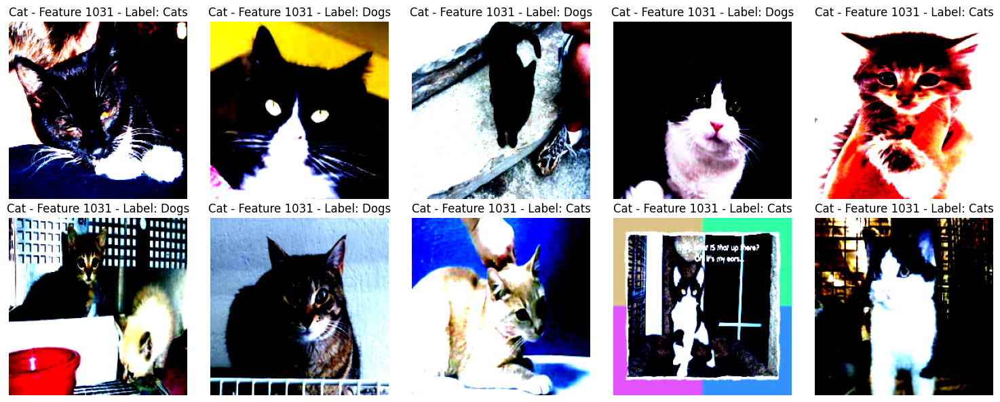

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

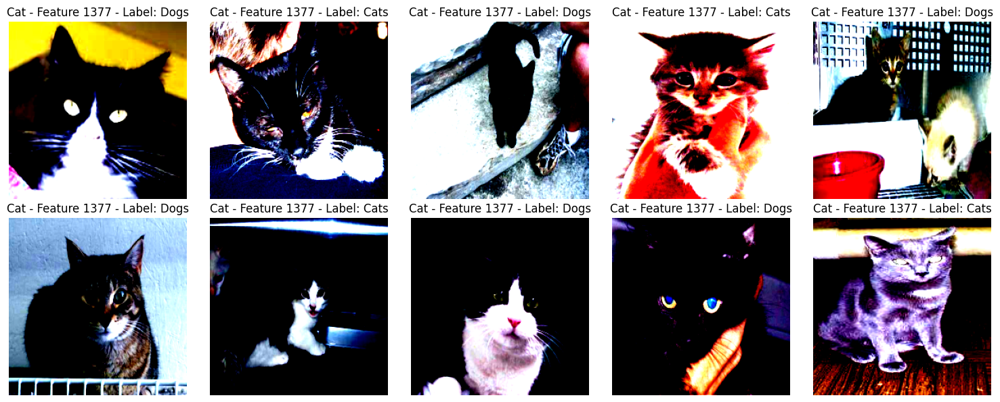

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

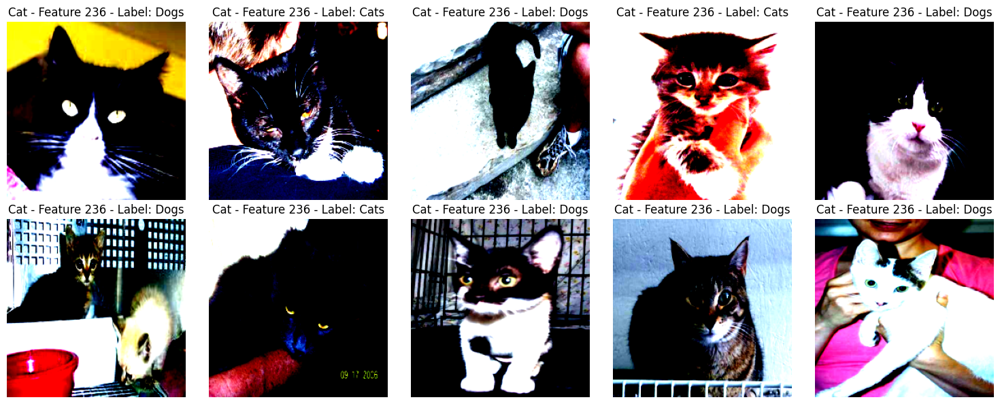

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

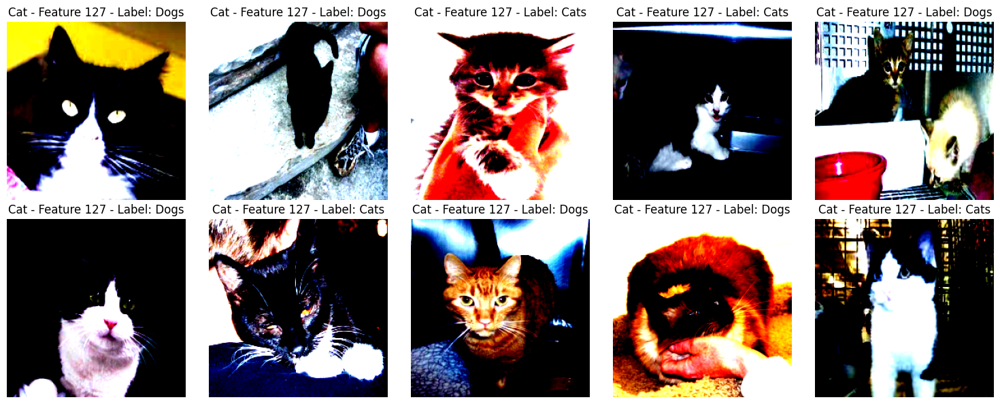

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

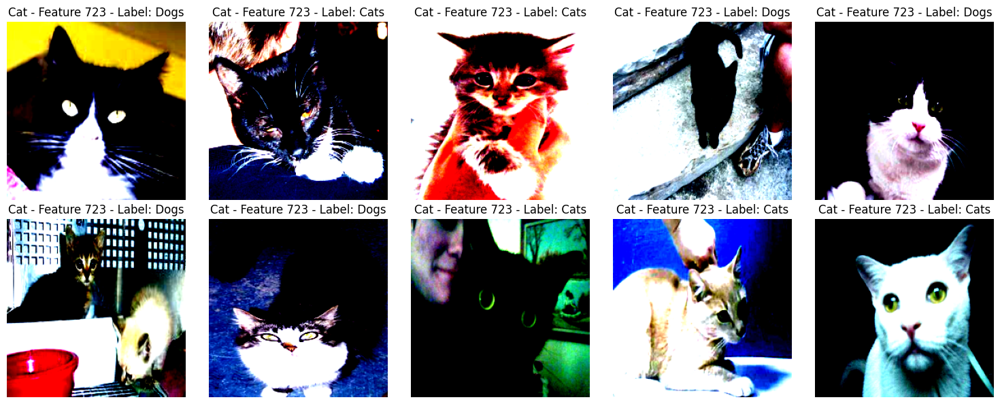

Current size of axis 1: 32


In [ ]:
# 提取特征映射
def extract_feature_maps(loader):
    feature_maps = []
    labels = []
    with torch.no_grad():
        for inputs, targets in loader:
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)
            feature_maps.append(outputs.squeeze().cpu().numpy())
            labels.extend(targets.cpu().numpy())
    return np.array(feature_maps), np.array(labels)

# 获取训练集特征映射和标签
feature_maps, labels = extract_feature_maps(train_loader)

# 假设已经训练好了随机森林分类器并获得特征重要度
importances = rf_classifier.feature_importances_

# 打印特征映射的形状
print(f"Shape of feature_maps: {feature_maps.shape}")

# 找到前五个重要特征的索引
cat_feature_indices = np.argsort(importances)[::-1][:5]
print("Top 5 important feature indices for cat class:", cat_feature_indices)

# 找到 top_k 张图像
def find_top_images_for_feature(feature_maps, labels, feature_index, top_k=10):
    try:
        # 确保 feature_index 在有效范围内
        assert 0 <= feature_index < feature_maps.shape[2], f"Feature index {feature_index} out of bounds."

        # 使用 argsort 找到排序后的索引
        top_images_indices = np.argsort(feature_maps[:, :, feature_index].flatten())[::-1][:top_k]
        top_images = []

        # 获取 top_k 张图像
        for idx in top_images_indices:
            # idx 可能超出范围，需确保 idx 的值在有效范围内
            valid_idx = idx // feature_maps.shape[1]
            image = train_dataset[valid_idx][0].permute(1, 2, 0).numpy()
            top_images.append((image, labels[valid_idx]))

        return top_images

    except Exception as e:
        print(f"Error in find_top_images_for_feature: {e}")
        return []  # 返回空列表或其他默认值

# 可视化前五个重要特征的 top_k 张图像
top_k = 10
for idx in cat_feature_indices:
    top_images = find_top_images_for_feature(feature_maps, labels, idx, top_k)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Cat - Feature {idx} - Label: {train_dataset.classes[label]}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")

# 打印当前轴的大小
current_axis_size = feature_maps.shape[1]
print(f"Current size of axis 1: {current_axis_size}")

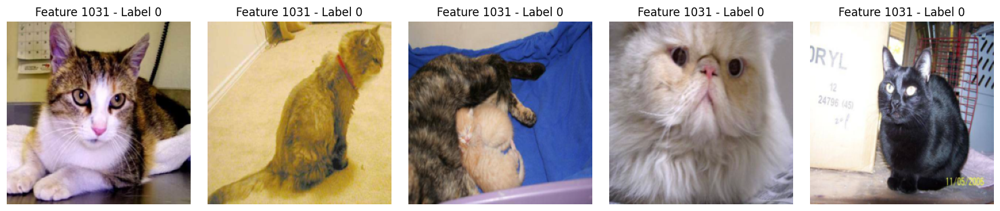

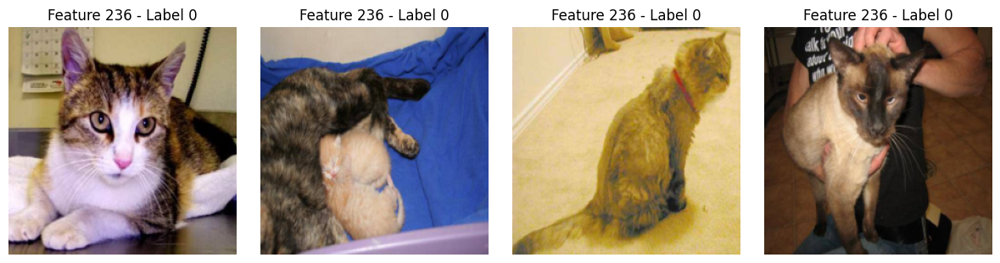

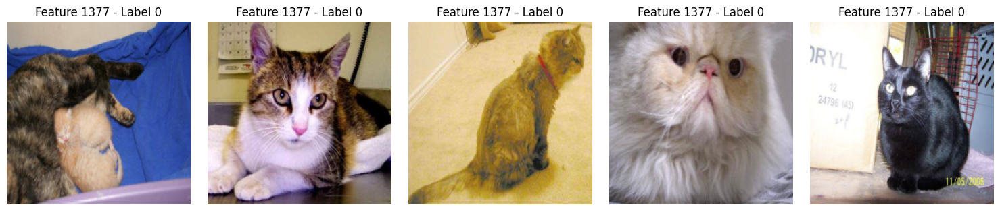

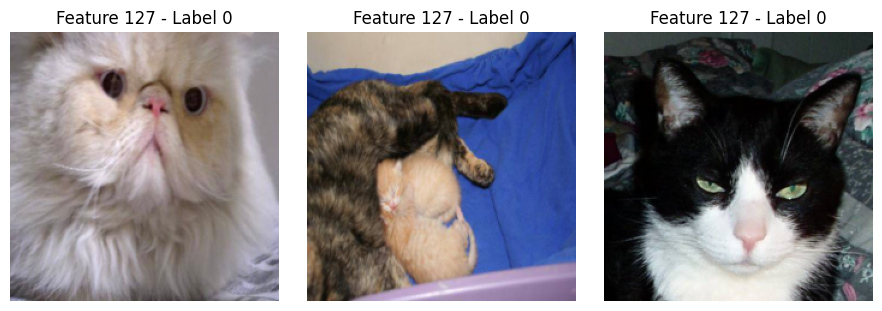

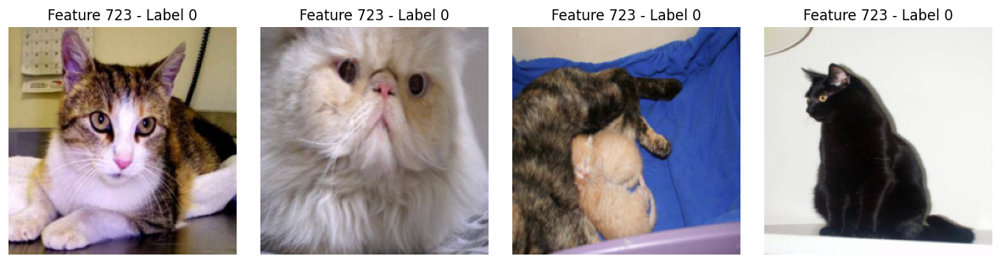

Current size of axis 1: 32


In [ ]:
from torchvision.datasets import ImageFolder


transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# 加載數據集
train_dataset = datasets.ImageFolder(root=os.path.join(data_dir, 'train'), transform=transform)
test_dataset = datasets.ImageFolder(root=os.path.join(data_dir, 'test'), transform=transform)

train_loader = DataLoader(dataset=train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=32, shuffle=False)

# 示例代码中的加载数据集的部分
train_dataset = ImageFolder(root='datasets_Cats_vs_Dogs/train', transform=transform)


# 提取特征映射
def extract_feature_maps(loader, model_fc):
    feature_maps = []
    labels = []
    indices = []
    with torch.no_grad():
        for i, (inputs, targets) in enumerate(loader):
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)
            feature_maps.append(outputs.squeeze().cpu().numpy())
            labels.extend(targets.cpu().numpy())
            indices.extend(range(i * inputs.size(0), (i + 1) * inputs.size(0)))
    return np.array(feature_maps), np.array(labels), np.array(indices)

# 获取训练集特征映射和标签
feature_maps, labels, indices = extract_feature_maps(train_loader, model_fc)

# 假设已经训练好了随机森林分类器并获得特征重要度
importances = rf_classifier.feature_importances_

# 找到前五个重要特征的索引
n_top_features = 5
top_feature_indices = np.argsort(importances)[::-1][:n_top_features]

# 找到 top_k 张图像
def find_top_images_for_feature(feature_maps, labels, feature_index, top_k=10):
    try:
        # 确保 feature_index 在有效范围内
        assert 0 <= feature_index < feature_maps.shape[2], f"Feature index {feature_index} out of bounds."

        # 使用 argsort 找到排序后的索引
        top_images_indices = np.argsort(feature_maps[:, :, feature_index].flatten())[::-1][:top_k]
        top_images = []

        # 获取 top_k 张图像
        for idx in top_images_indices:
            original_idx = indices[idx // feature_maps.shape[1]]
            # idx 可能超出范围，需确保 idx 的值在有效范围内
            
            image, label = train_dataset[original_idx]  # 直接使用 valid_idx 来获取图片和标签
            image = image.permute(1, 2, 0).numpy()
            image = (image - image.min()) / (image.max() - image.min())
            top_images.append((image,label))     

        return top_images

    except Exception as e:
        print(f"Error in find_top_images_for_feature: {e}")
        return []  # 返回空列表或其他默认值



# 对每个重要特征索引找到响应最大的图像并输出
top_k = 10
for idx in top_feature_indices:
    top_images = find_top_images_for_feature(feature_maps, labels, idx, top_k)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Feature {idx} - Label {label}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")

# 打印当前轴的大小
current_axis_size = feature_maps.shape[1]
print(f"Current size of axis 1: {current_axis_size}")


Cat class important features and corresponding images:


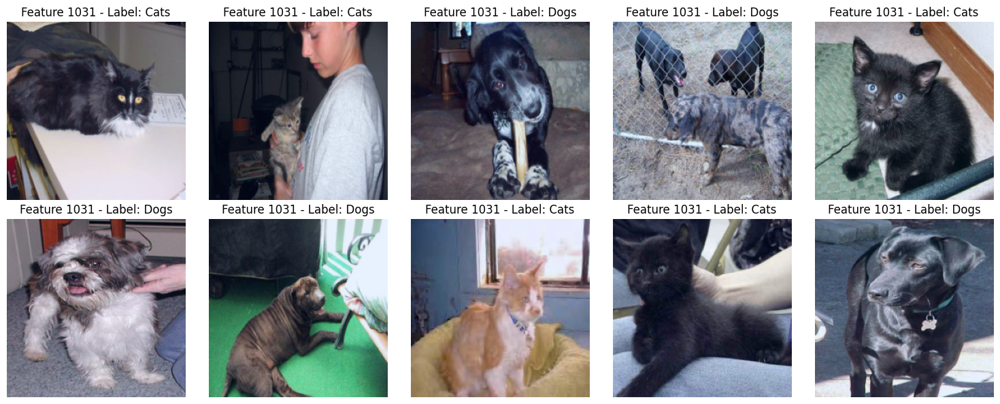

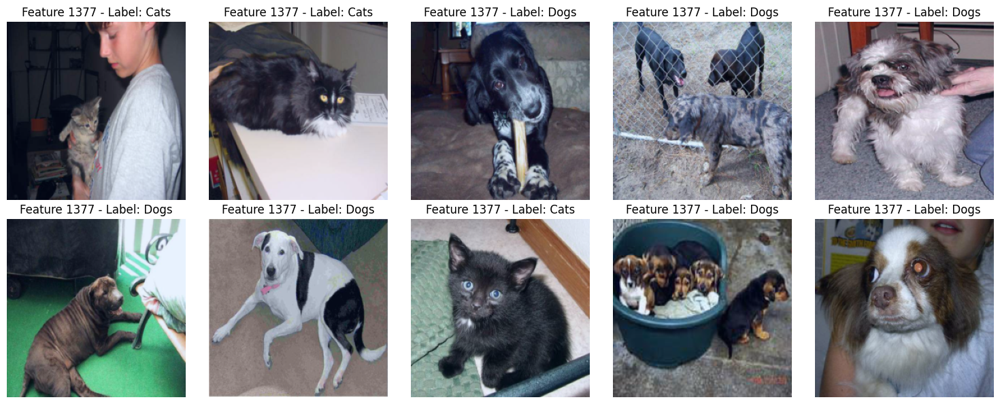

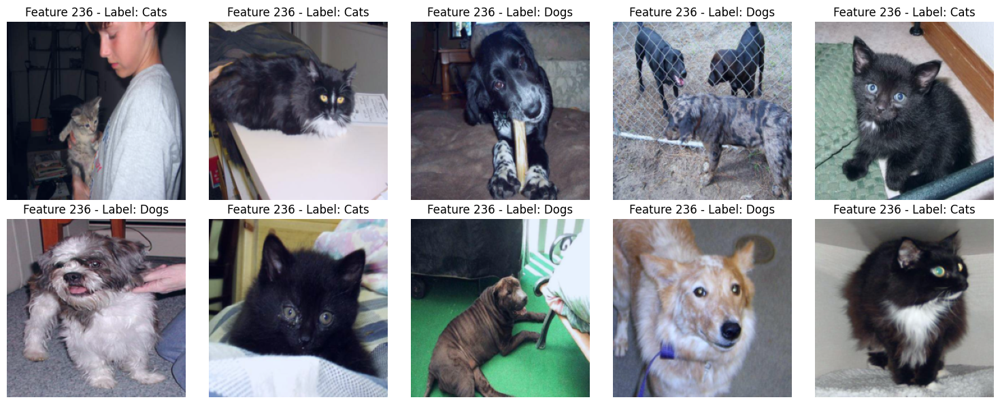

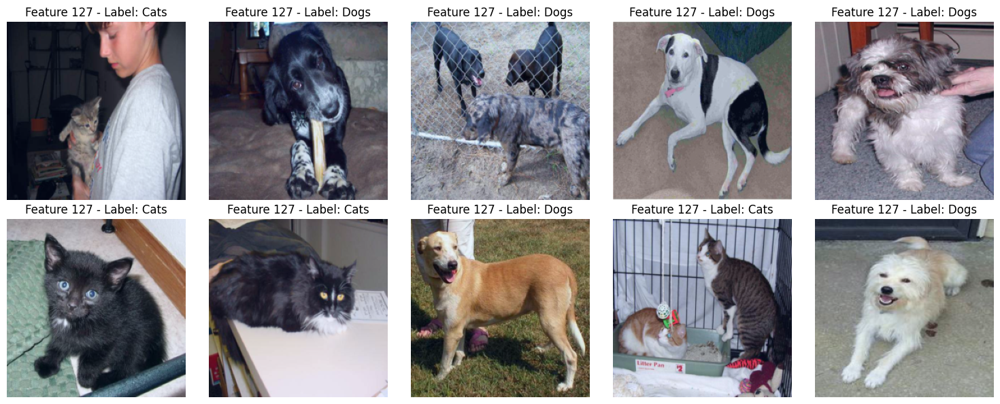

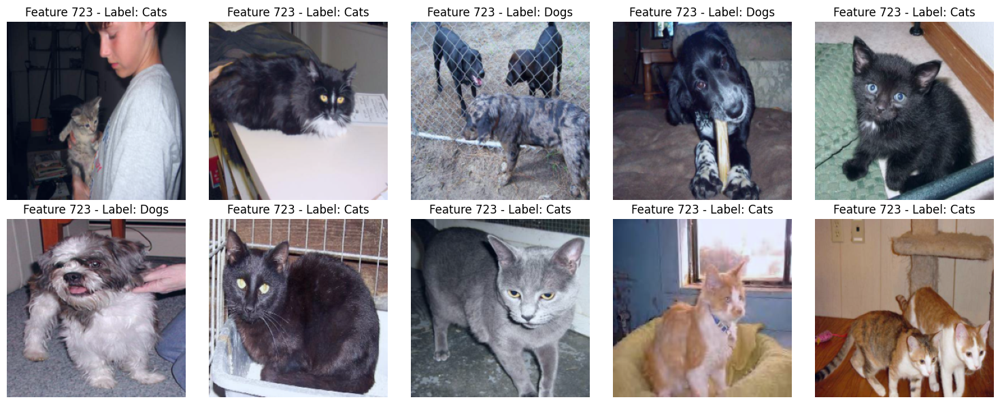

Dog class important features and corresponding images:


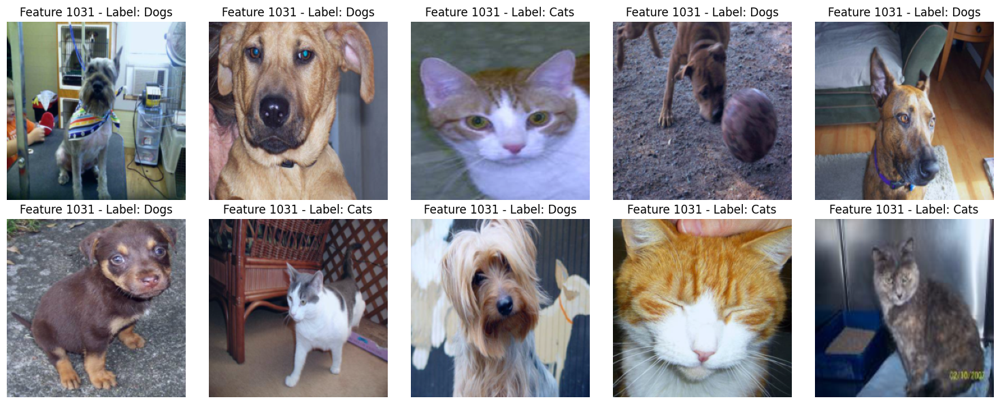

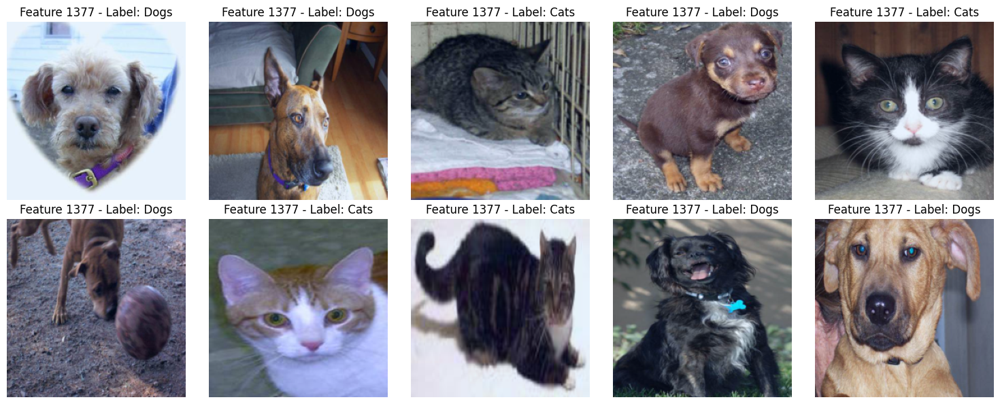

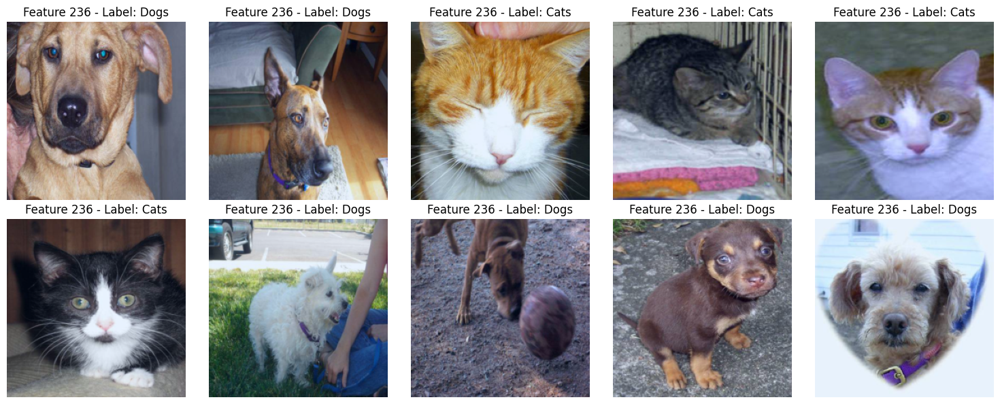

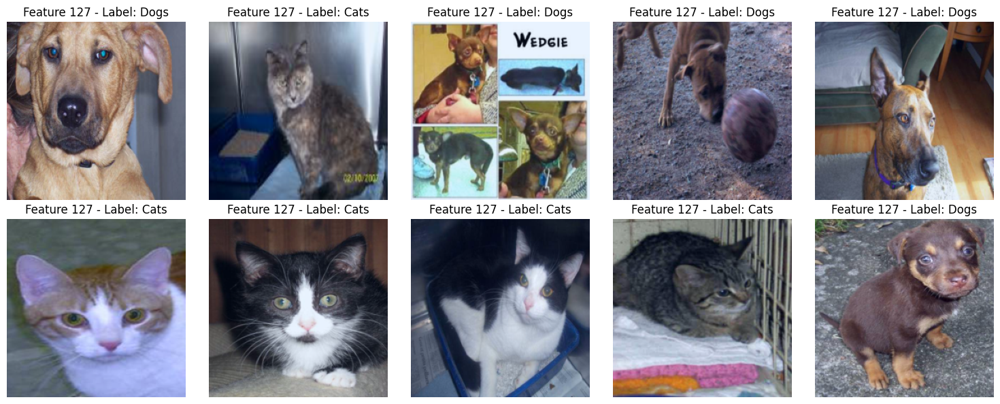

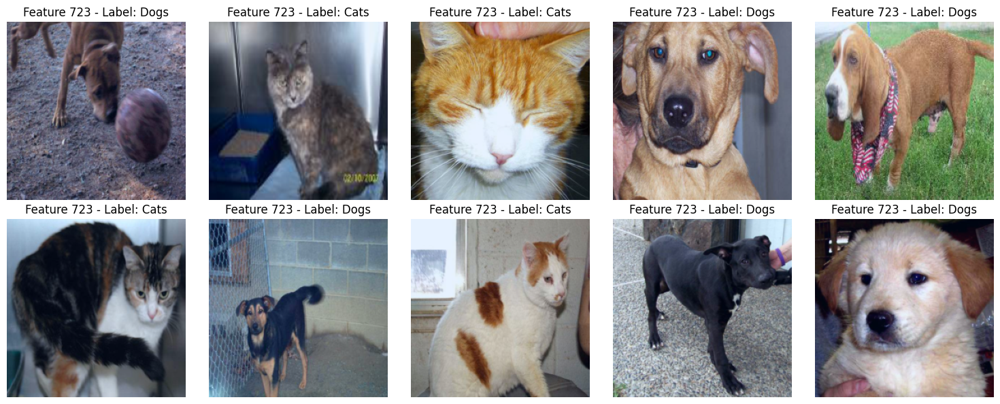

Current size of axis 1: 2048


In [ ]:
import torch
import numpy as np

import matplotlib.pyplot as plt
from torchvision.datasets import ImageFolder
from torchvision import transforms
from sklearn.ensemble import RandomForestClassifier



# 图像预处理
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# 加载数据集
train_dataset = ImageFolder(root='datasets_Cats_vs_Dogs/train', transform=transform)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)

# 提取特征映射
def extract_feature_maps(loader):
    feature_maps = []
    labels = []
    indices = []  # 记录图像的原始索引
    with torch.no_grad():
        for i, (inputs, targets) in enumerate(loader):
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)
            feature_maps.append(outputs.cpu().numpy())
            labels.append(targets.cpu().numpy())
            indices.extend(range(i * inputs.size(0), (i + 1) * inputs.size(0)))
    return np.concatenate(feature_maps), np.concatenate(labels), np.array(indices)

# 获取训练集特征映射和标签
feature_maps, labels, indices = extract_feature_maps(train_loader)

# 分别获取猫和狗的特征和标签
cat_indices = np.where(labels == 0)[0]
dog_indices = np.where(labels == 1)[0]

cat_feature_maps = feature_maps[cat_indices]
dog_feature_maps = feature_maps[dog_indices]

cat_labels = labels[cat_indices]
dog_labels = labels[dog_indices]

# 展平特征映射
cat_feature_maps_flat = cat_feature_maps.reshape(cat_feature_maps.shape[0], -1)
dog_feature_maps_flat = dog_feature_maps.reshape(dog_feature_maps.shape[0], -1)

# 训练随机森林分类器
rf_classifier_cat = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier_dog = RandomForestClassifier(n_estimators=100, random_state=42)

rf_classifier_cat.fit(cat_feature_maps_flat, cat_labels)
rf_classifier_dog.fit(dog_feature_maps_flat, dog_labels)

# 获取特征重要性
cat_importances = rf_classifier_cat.feature_importances_
dog_importances = rf_classifier_dog.feature_importances_

# 找到前五个重要特征的索引
n_top_features = 5
top_cat_feature_indices = [1031,1377,236,127,723]
top_dog_feature_indices = [1031,1377,236,127,723]

# 找到 top_k 张图像
def find_top_images_for_feature(feature_maps, labels, indices, feature_index, top_k=10):
    try:
        # 确保 feature_index 在有效范围内
        assert 0 <= feature_index < feature_maps.shape[1], f"Feature index {feature_index} out of bounds."

        # 使用 argsort 找到排序后的索引
        top_images_indices = np.argsort(feature_maps[:, feature_index].flatten())[::-1][:top_k]
        top_images = []

        # 获取 top_k 张图像
        for idx in top_images_indices:
            # 通过 flatten 的索引找到原始的 feature_maps 索引
            original_idx = indices[idx]
            image, label = train_dataset[original_idx]  # 直接使用 original_idx 来获取图片和标签
            image = image.permute(1, 2, 0).numpy()

            # 确保图像数据在 [0, 1] 范围内
            image = (image - image.min()) / (image.max() - image.min())

            top_images.append((image, label))

        return top_images

    except Exception as e:
        print(f"Error in find_top_images_for_feature: {e}")
        return []

# 对每个重要特征索引找到响应最大的图像并输出
top_k = 10

print("Cat class important features and corresponding images:")
for idx in top_cat_feature_indices:
    top_images = find_top_images_for_feature(cat_feature_maps, cat_labels, cat_indices, idx, top_k)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Feature {idx} - Label: {train_dataset.classes[label]}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")

print("Dog class important features and corresponding images:")
for idx in top_dog_feature_indices:
    top_images = find_top_images_for_feature(dog_feature_maps, dog_labels, dog_indices, idx, top_k)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Feature {idx} - Label: {train_dataset.classes[label]}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")

# 打印当前轴的大小
current_axis_size = feature_maps.shape[1]
print(f"Current size of axis 1: {current_axis_size}")


In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import os

# 转换
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# 数据路径
data_dir = 'e:\\code\\Cat_vs_Dog\\datasets_Cats_vs_Dogs\\train'

# 加载数据集
dataset = datasets.ImageFolder(root=data_dir, transform=transform)

# 创建数据加载器
loader = DataLoader(dataset=dataset, batch_size=32, shuffle=False)

print("Data loading complete.")




Data loading complete.


In [ ]:
from PIL import Image
import numpy as np

def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img_path = os.path.join(folder, filename)
        try:
            img = Image.open(img_path).convert('RGB')
            images.append(img)
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
    return images

cat_images = load_images_from_folder('e:\\code\\Cat_vs_Dog\\datasets_Cats_vs_Dogs\\train\\Cats')
dog_images = load_images_from_folder('e:\\code\\Cat_vs_Dog\\datasets_Cats_vs_Dogs\\train\\Dogs')

print(f"Loaded {len(cat_images)} cat images")
print(f"Loaded {len(dog_images)} dog images")


Loaded 8000 cat images
Loaded 8000 dog images


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# 如果需要将图片转换为数据集以用于 DataLoader
class CustomImageDataset(torch.utils.data.Dataset):
    def __init__(self, images, labels,transform=None):
        self.images = images
        self.labels = labels
        self.transform = transform
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        return self.images[idx], self.labels[idx]

# 创建数据集对象
cat_labels = [0] * len(cat_images)  # 猫的标签为0
dog_labels = [1] * len(dog_images)  # 狗的标签为1

# 数据转换


cat_dataset = CustomImageDataset(images=cat_images, labels=cat_labels, transform=transform)
dog_dataset = CustomImageDataset(images=dog_images, labels=dog_labels, transform=transform)


# 创建 DataLoader
cat_loader = DataLoader(dataset=cat_dataset, batch_size=32, shuffle=False)
dog_loader = DataLoader(dataset=dog_dataset, batch_size=32, shuffle=False)

print("DataLoader for cat and dog images are created.")

TypeError: __init__() got an unexpected keyword argument 'images'

In [ ]:
# 提取特征映射函数
def extract_feature_maps(loader, model_fc):
    feature_maps = []
    labels = []
    indices = []
    with torch.no_grad():
        for inputs, targets in loader:
            inputs = inputs.to('cuda')
            outputs = model_fc(inputs)  # 请确保 model_fc 是你训练好的模型
            feature_maps.append(outputs.squeeze().cpu().numpy())
            labels.extend(targets.cpu().numpy())
            indices.extend(range(len(labels) - len(targets), len(labels)))
    return np.array(feature_maps), np.array(labels), np.array(indices)

# 获取猫的特征映射和标签
cat_feature_maps, cat_labels, cat_indices = extract_feature_maps(cat_loader, model_fc)

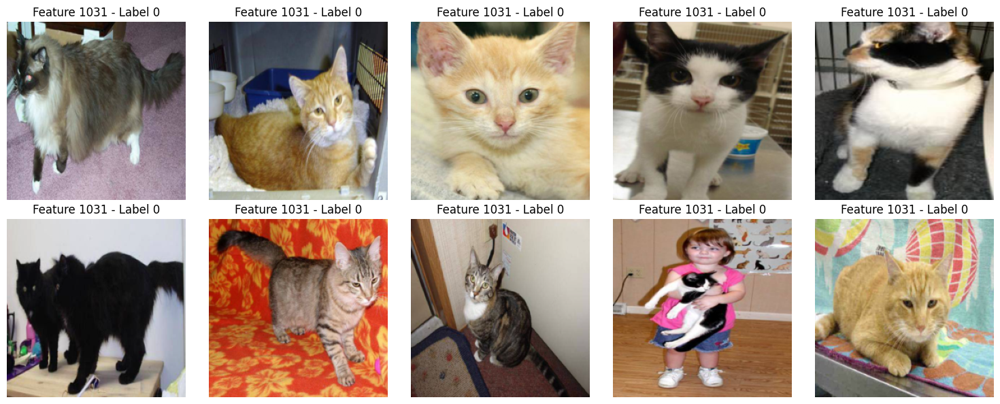

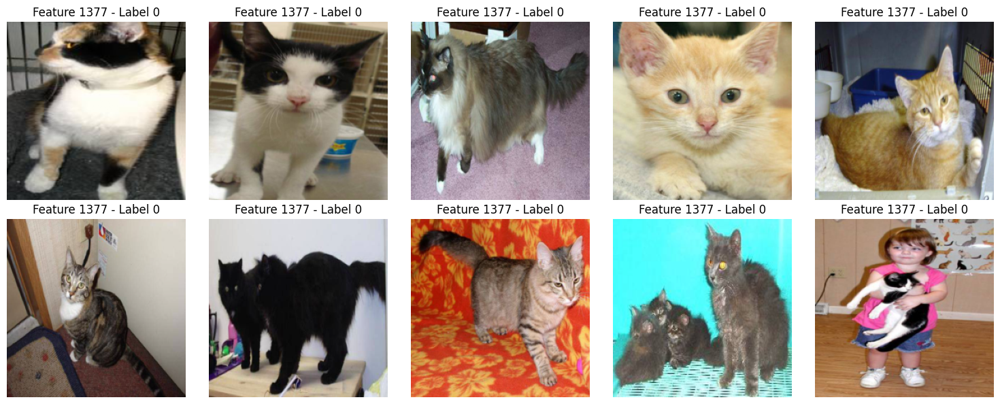

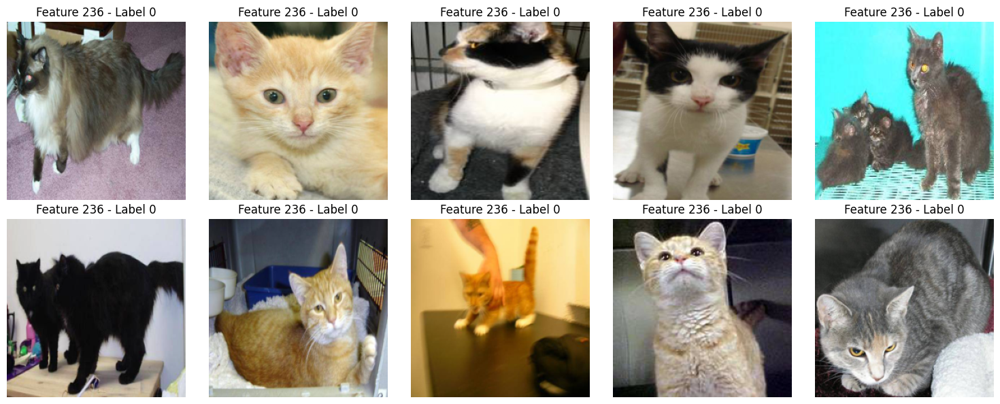

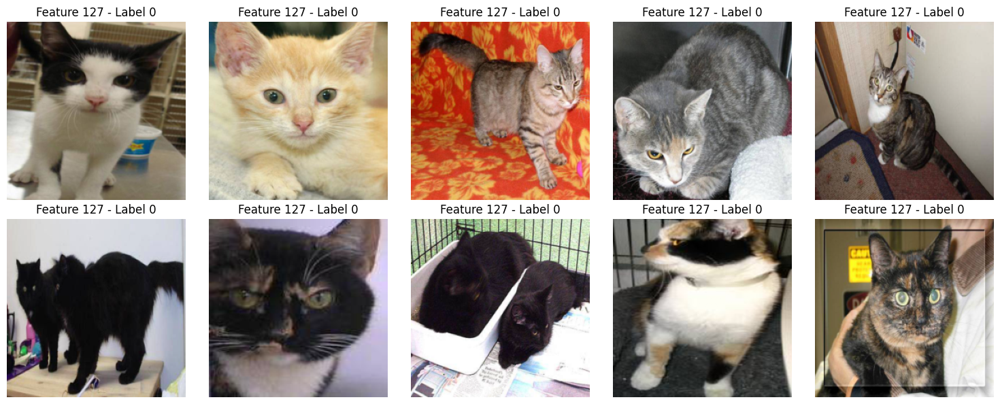

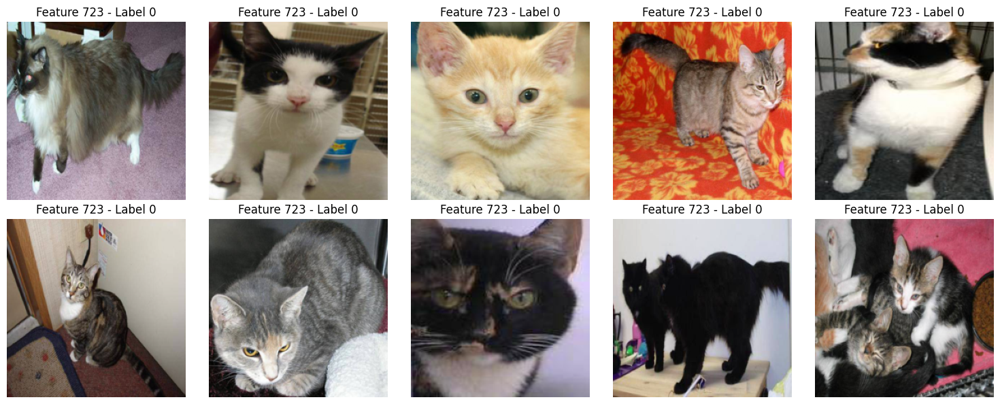

In [ ]:
top_cat_feature_indices = [1031,1377,236,127,723]

def find_top_images_for_feature(feature_maps, indices, feature_index, top_k=10):
    try:
        assert 0 <= feature_index < feature_maps.shape[2], f"Feature index {feature_index} out of bounds."
        
        # 找到前 top_k 响应最大的图像索引
        top_indices = np.argsort(feature_maps[:, :, feature_index].flatten())[::-1][:top_k]
        top_images = []

        # 获取 top_k 图像
        for idx in top_indices:
            original_idx = indices[idx // feature_maps.shape[1]]
            image, label = cat_dataset[original_idx]
            image = image.permute(1, 2, 0).numpy()
            image = (image - image.min()) / (image.max() - image.min())
            top_images.append((image, label))
            

        return top_images

    except Exception as e:
        print(f"Error in find_top_images_for_feature: {e}")
        return []

# 对每个猫类重要特征索引找到响应最大的图像并输出
top_k = 10
for idx in top_cat_feature_indices:
    top_images = find_top_images_for_feature(cat_feature_maps, cat_indices, idx, top_k)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Feature {idx} - Label {label}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")


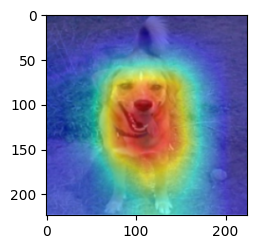

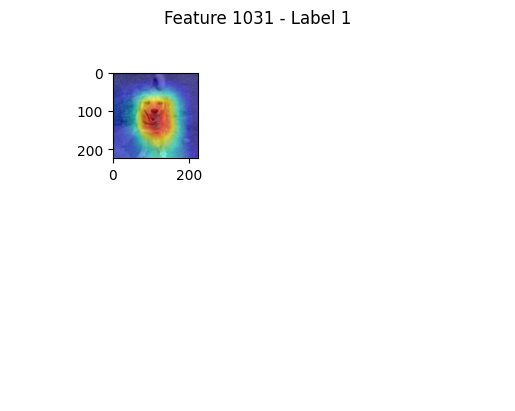

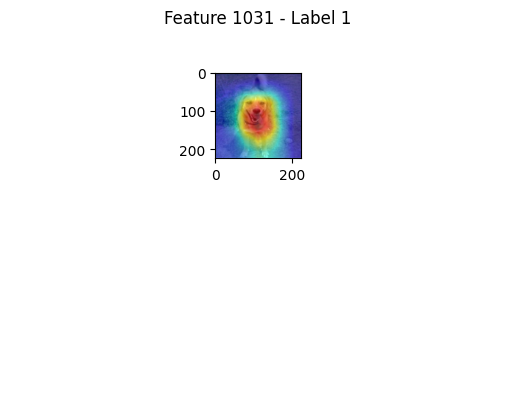

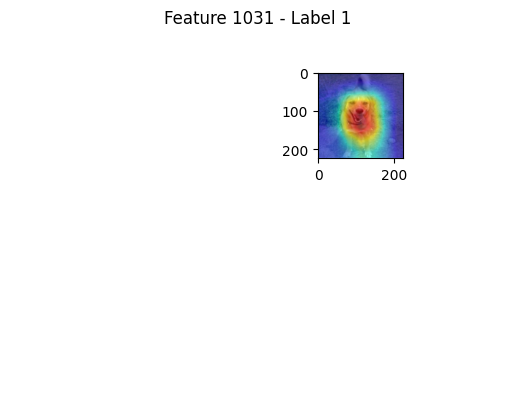

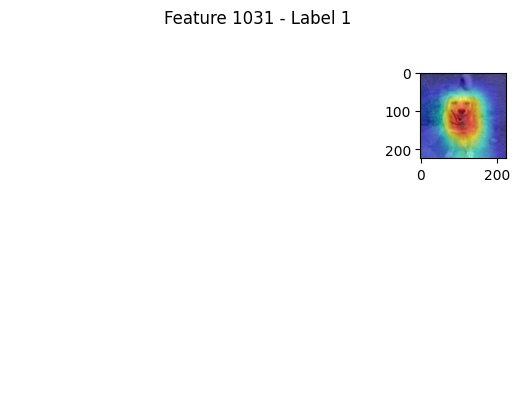

...

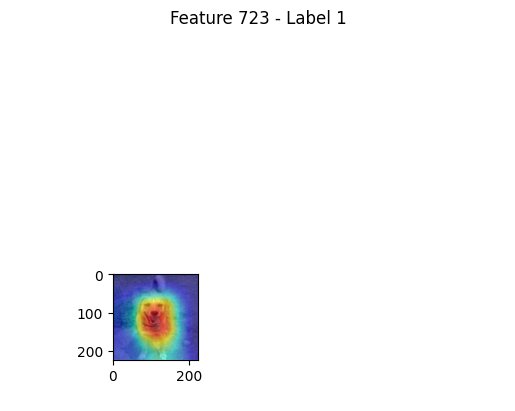

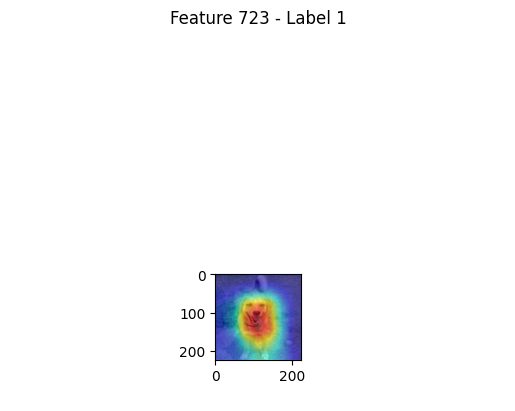

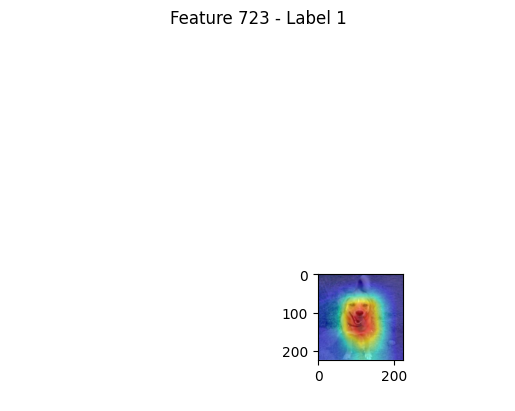

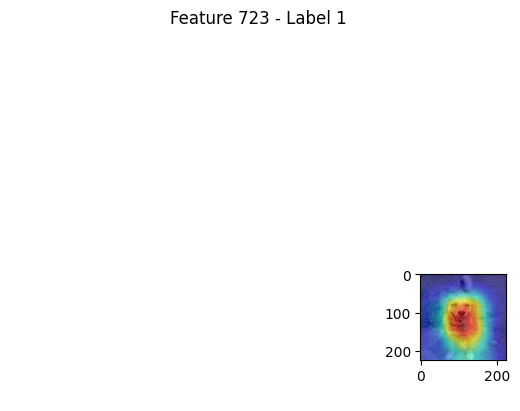

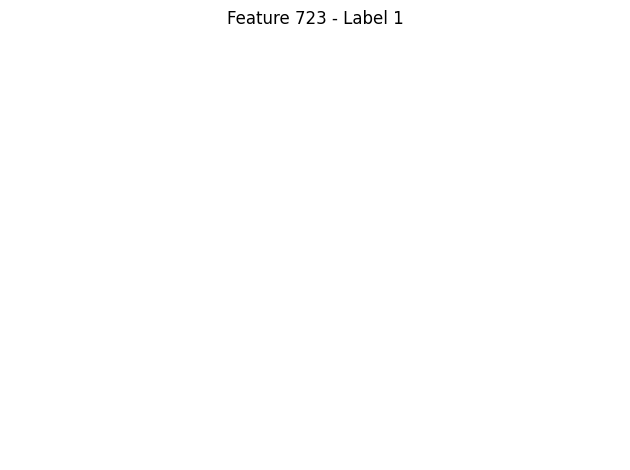

In [ ]:
def find_top_images_for_feature_dog(feature_maps, indices, feature_index, top_k=10):
    try:
        assert 0 <= feature_index < feature_maps.shape[2], f"Feature index {feature_index} out of bounds."
        
        # 找到前 top_k 响应最大的图像索引
        top_indices = np.argsort(feature_maps[:, :, feature_index].flatten())[::-1][:top_k]
        top_images = []

        # 获取 top_k 图像
        for idx in top_indices:
            original_idx = indices[idx // feature_maps.shape[1]]
            image, label = dog_dataset[original_idx]
            image = image.permute(1, 2, 0).numpy()
            image = (image - image.min()) / (image.max() - image.min())
            top_images.append((image, label))

        return top_images

    except Exception as e:
        print(f"Error in find_top_images_for_feature: {e}")
        return []

def generate_and_show_cam(image_path, model, target_layer, transform, feature_index, top_k=10):
    img_tensor = preprocess_image(image_path).to(device)
    cam = generate_cam(model, target_layer, img_tensor, class_idx=None)  # class_idx=None means max score class

    # 显示热力图
    show_cam_on_image(image_path, cam)

# 获取狗的特征映射和标签
dog_feature_maps, dog_labels, dog_indices = extract_feature_maps(dog_loader,model_fc)

# 计算狗类特征的重要性
top_dog_feature_indices = [1031,1377,236,127,723]

# 对每个狗类重要特征索引找到响应最大的图像并输出
for idx in top_dog_feature_indices:
    top_images = find_top_images_for_feature_dog(dog_feature_maps, dog_indices, idx, top_k)
    if top_images:
        plt.figure(figsize=(15, 6))
        for i, (image, label) in enumerate(top_images):
            plt.subplot(2, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Feature {idx} - Label {label}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")


In [ ]:
# 修改 find_top_images_for_feature_dog 函数以返回图像路径
def find_top_images_for_feature_dog(feature_maps, indices, feature_index, top_k=10):
    try:
        assert 0 <= feature_index < feature_maps.shape[2], f"Feature index {feature_index} out of bounds."
        
        # 找到前 top_k 响应最大的图像索引
        top_indices = np.argsort(feature_maps[:, :, feature_index].flatten())[::-1][:top_k]
        top_images = []

        # 获取 top_k 图像
        for idx in top_indices:
            original_idx = indices[idx // feature_maps.shape[1]]
            _, _, img_path = dog_dataset[original_idx]  # 获取图像路径
            top_images.append(img_path)

        return top_images

    except Exception as e:
        print(f"Error in find_top_images_for_feature_dog: {e}")
        return []

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from torchvision import transforms
import torch

# 用于生成 CAM 的辅助函数
def preprocess_image(img_path):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    img = Image.open(img_path).convert('RGB')
    img = transform(img).unsqueeze(0)
    return img

def generate_cam(model, target_layer, img_tensor, class_idx=None):
    model.eval()
    feature_maps = []
    gradients = []

    def forward_hook(module, input, output):
        feature_maps.append(output)

    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])

    handle_forward = target_layer.register_forward_hook(forward_hook)
    handle_backward = target_layer.register_backward_hook(backward_hook)

    output = model(img_tensor)
    if class_idx is None:
        class_idx = torch.argmax(output).item()

    model.zero_grad()
    class_loss = output[0, class_idx]
    class_loss.backward()

    handle_forward.remove()
    handle_backward.remove()

    feature_map = feature_maps[0].detach().cpu().numpy()[0]
    gradient = gradients[0].detach().cpu().numpy()[0]

    weights = np.mean(gradient, axis=(1, 2))
    cam = np.sum(weights[:, np.newaxis, np.newaxis] * feature_map, axis=0)
    cam = np.maximum(cam, 0)
    cam = cam / cam.max()
    cam = cv2.resize(cam, (img_tensor.size(2), img_tensor.size(3)))

    return cam

def show_cam_on_image(img_path, cam):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255

    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    superimposed_img = heatmap + np.float32(img) / 255
    superimposed_img = superimposed_img / np.max(superimposed_img)
    return np.uint8(255 * superimposed_img)

# 获取狗的特征映射和标签
dog_feature_maps, dog_labels, dog_indices = extract_feature_maps(dog_loader, model_fc)

# 计算狗类特征的重要性
top_dog_feature_indices = [1031, 1377, 236, 127, 723]

# 对每个狗类重要特征索引找到响应最大的图像并输出
for idx in top_dog_feature_indices:
    top_image_paths = find_top_images_for_feature_dog(dog_feature_maps, dog_indices, idx, top_k)
    if top_image_paths:
        plt.figure(figsize=(15, 6))
        for i, image_path in enumerate(top_image_paths):
            plt.subplot(2, 5, i + 1)
            img_tensor = preprocess_image(image_path).to(device)
            cam = generate_cam(model, target_layer, img_tensor)
            cam_image = show_cam_on_image(image_path, cam)
            plt.imshow(cam_image)
            plt.title(f'Feature {idx}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found for feature index: {idx}")


AttributeError: 'CustomImageDataset' object has no attribute 'image_paths'